In [4]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Colab Notebooks/코드 이론/Paper review

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Colab Notebooks/코드 이론/Paper review


In [8]:
import torch
import torch.nn as nn
import torchvision
from torchvision.datasets import OxfordIIITPet
from torchvision import models, transforms
import torch.nn.functional as F
from PIL import Image
from matplotlib import pyplot as plt
import urllib.request
import ast
import numpy as np
import os
import cv2
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# class of ImageNet
class_url = 'https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt'
with urllib.request.urlopen(class_url) as handler:
    data = handler.read().decode()
    classes = ast.literal_eval(data)

# 샘플 이미지 업로드 후 실행
img_list = []
for img in os.listdir('./'):
    if img.endswith('.jpg'):
        img_list.append(img)

# 전처리 정보 : ImageNet transform
# https://github.com/pytorch/examples/blob/42e5b996718797e45c46a25c55b031e6768f8440/imagenet/main.py#L89-L101
# 1. 예측 전처리
preprocess1 = transforms.Compose([
    # transforms.Resize(256), # 비율 맞춰서 이미지 규격 조정 ; 긴 모서리가 남을 수 있음 ; 비율 왜곡으로 인한 성능 저하를 더 예방 ; 예측에 사용할 이미지에 따라 적절히 다른 처리 필요
    # transforms.CenterCrop(224), # 중심 기준 정방형
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
# 2. 시각화 전처리 ; ToTensor, Normalize 제외
preprocess2 = transforms.Compose([
    # transforms.Resize(256),
    # transforms.CenterCrop(224)
    transforms.Resize((224,224))
])

# 샘플 이미지
raw_img0 = Image.open(img_list[0])
img_input0 = preprocess1(raw_img0) # 예측 용도
numpy_img0 = np.asarray(preprocess2(raw_img0)) # 시각화 용도
print(img_input0.shape)
print(numpy_img0.shape)

torch.Size([3, 224, 224])
(224, 224, 3)


In [7]:
img_list

[]

In [ ]:
# vgg19 구조 구체적 확인 예시
model = models.vgg19(weights='DEFAULT')
print(len(list(model.children())))
for name, child in model.named_children():
    print('\n')
    print(f'>>>{name}')
    print(child)

In [9]:
# GradCAM(model_name) : 입력받은 model에서 Grad-CAM 구현에 필요한 기능을 함께 정의
class GradCAM(nn.Module):
    def __init__(self, model_name):
        super().__init__()
        if model_name=='resnet18':
            resnet = models.resnet18(weights='DEFAULT')
            self.encoder = nn.Sequential(*(list(resnet.children())[:-2]))
            self.pool = resnet.avgpool
            self.classifier = resnet.fc

        elif model_name=='vgg19':
            vgg = models.vgg19(weights='DEFAULT')
            self.encoder = vgg.features
            self.pool = vgg.avgpool
            self.classifier = vgg.classifier

        else:
            assert False, f'not implemented'

        self.gradients = None

    def gradients_hook(self, grad):
        self.gradients = grad

    def forward(self, x):
        x = self.encoder(x)
        x.register_hook(self.gradients_hook)
            # x.register_hook(f) : f(x.grad) invoked when the gradients of x are computed during backpropagation
        x = self.pool(x)
        x = x.flatten(start_dim=1) # start_dim=1 : 배치 차원 제외하고 classification의 Linear 레이어에 대한 입력 형식으로 변환
        x = self.classifier(x)
        return x

    def feature_extraction(self, x):
        return self.encoder(x)

EXPERIMENT

In [10]:
# 모델 이름과 이미지 경로 받아서 예측 후 coarse Grad-CAM과 예측 레이블 반환
def gradcam_exp(model_name, img_path):
    raw_img = Image.open(img_path)
    img_input = preprocess1(raw_img).to(device).unsqueeze(dim=0)
    numpy_img = np.asarray(preprocess2(raw_img))

    model = GradCAM(model_name).to(device)
    model.eval()

    img_label = img_path[:-5]
    result = []
    cls_label = []

    # top-1,2
    for t in range(2):
        pred = model(img_input)
        cls_idx = torch.argsort(-pred, dim=1)[0][t]
        cls_label.append(classes[cls_idx.item()])

        pred[:, cls_idx].backward()
        gradients = model.gradients.detach() # gradients : (1, 512, feat_h, feat_w)

        '''기존의 gradcam과 다르게 구현'''
        # attr = torch.mean(gradients, dim=[0,2,3]) # attr : (512,)
            # attribution of k-th channel of feature maps for each top-t class measured by average pooling
        feature_map = model.feature_extraction(img_input).detach() # feature_map : (1, 512, feat_h, feat_w)
        # coarse Grad-CAM
        # for i in range(512):
            # feature_map[:,i,:,:] *= attr[i]
        feature_map *= gradients

        heatmap = F.relu(torch.sum(feature_map, dim=1).squeeze()) # heatmap : (feat_h, feat_w)
        # heatmap = torch.sum(feature_map, dim=1).squeeze() # relu 제외
        # heatmap 생성
        heatmap -= heatmap.min()
        heatmap /= heatmap.max()
        heatmap = np.uint8(255 * heatmap.cpu().numpy()) # 0~255 정수로 변환
        # colormap 변환 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
        heatmap = cv2.applyColorMap(cv2.resize(255-heatmap, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
        # heatmap 적용
        result.append(np.uint8(numpy_img*0.5 + heatmap*0.3))

    return numpy_img, result, img_label, cls_label # 원본 이미지 시각화 용도, grad-cam 시각화 용도 top-1,2, 예측 레이블 top-1,2

In [11]:
def visualize_gradcam(numpy_img, result, img_label, cls_label):
    fig = plt.figure(figsize=(15, 5))
    # 원본 이미지
    ax1 = fig.add_subplot(1, 3, 1)
    ax1.imshow(numpy_img)
    ax1.set_title(img_label, fontsize=10)
    ax1.axis('off')
    # CAM 이미지 top-1
    ax2 = fig.add_subplot(1, 3, 2)
    ax2.imshow(result[0])
    ax2.set_title(f"[{cls_label[0]}] CAM 1", fontsize=10)
    ax2.axis('off')
    # CAM 이미지 top-2
    ax3 = fig.add_subplot(1, 3, 3)
    ax3.imshow(result[1])
    ax3.set_title(f"[{cls_label[1]}] CAM 2", fontsize=10)
    ax3.axis('off')

    plt.show()

### exp_resnet

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 213MB/s]


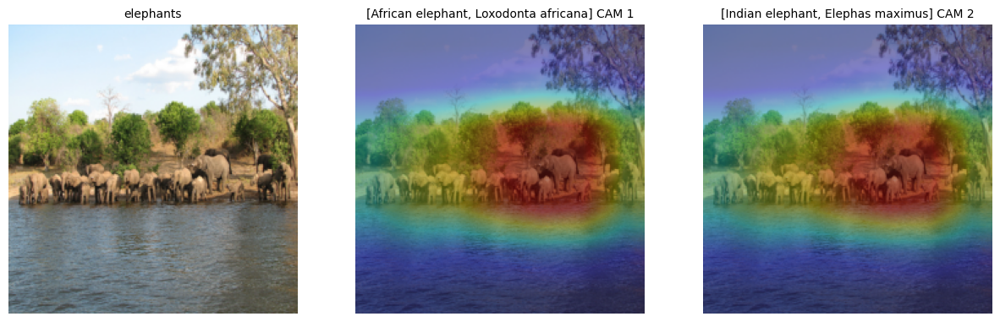

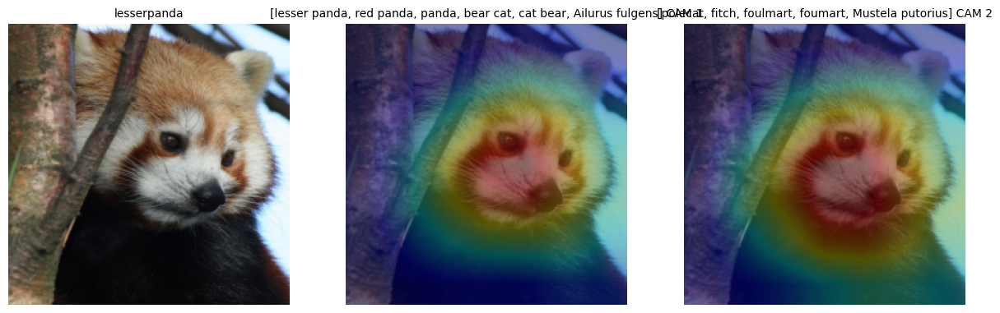

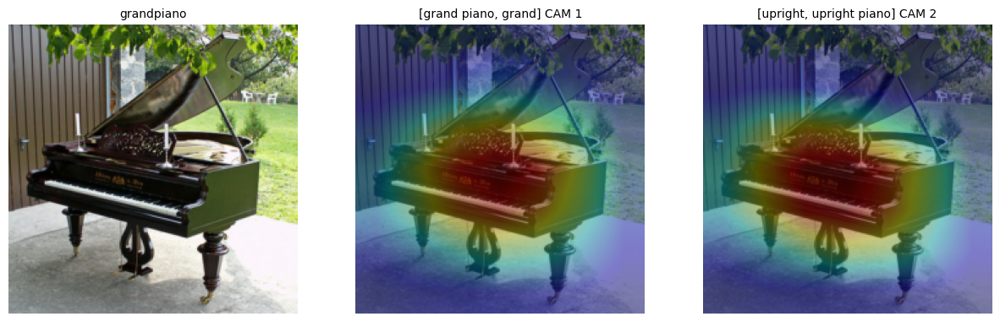

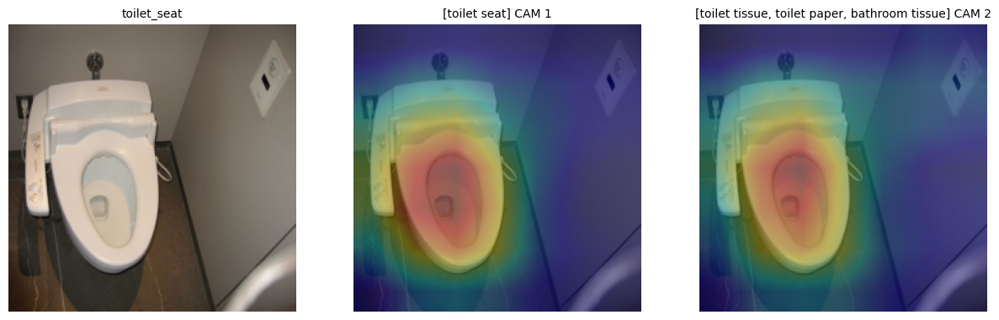

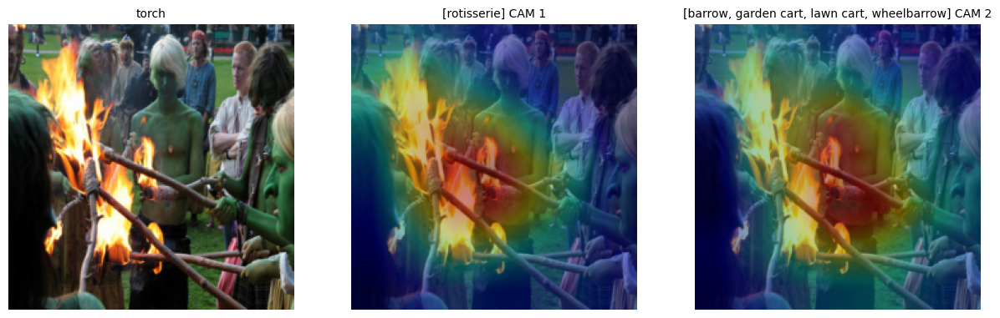

...

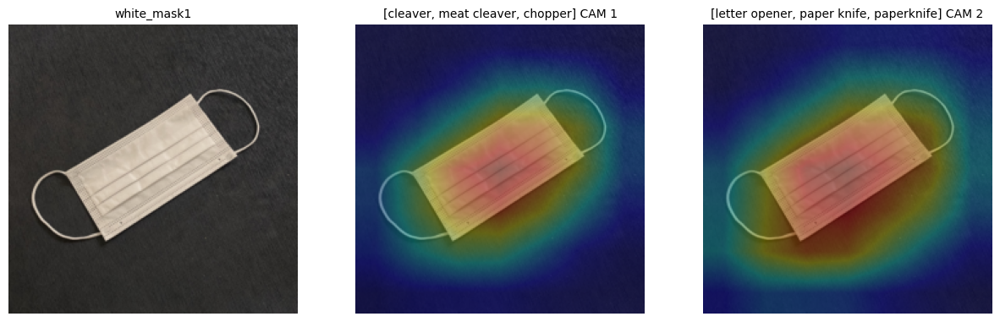

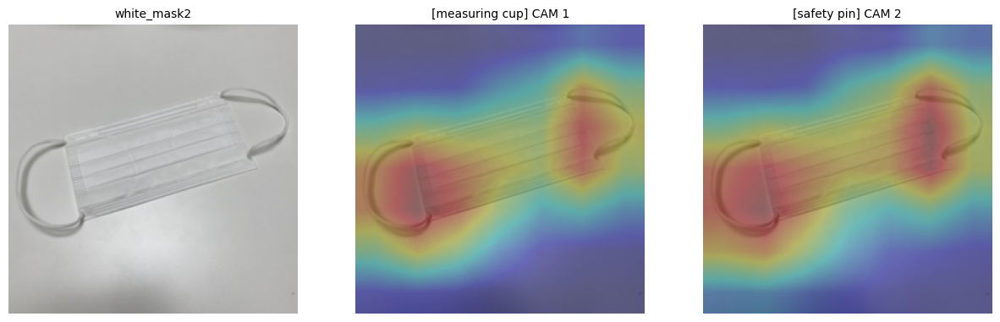

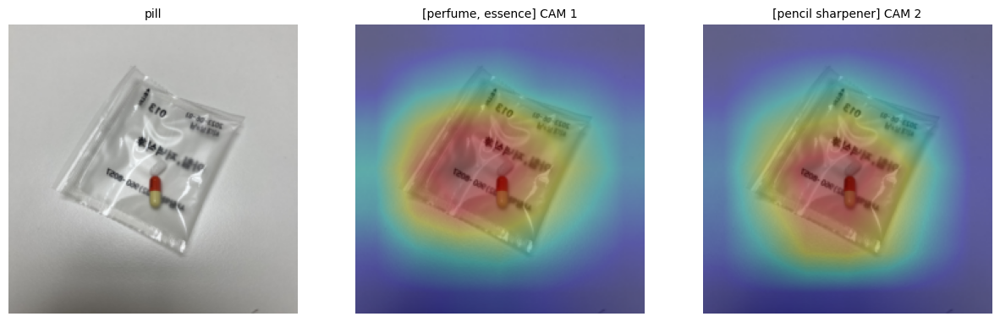

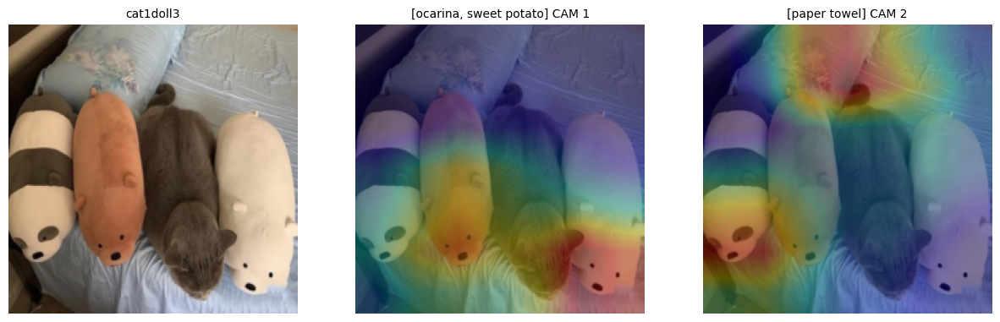

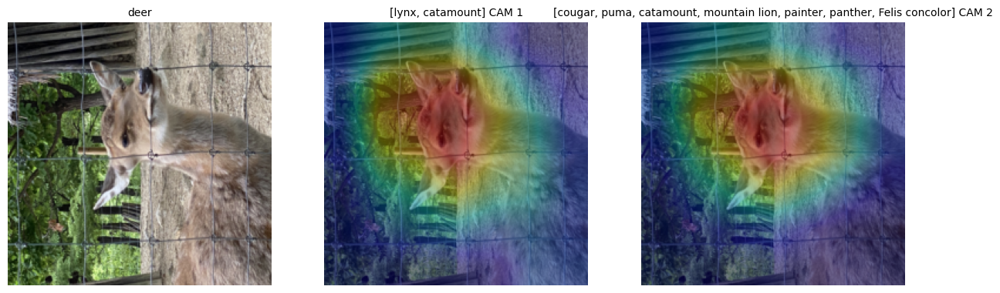

In [ ]:
for p in img_list:
    visualize_gradcam(*gradcam_exp(model_name='resnet18', img_path=p))

### exp_vgg

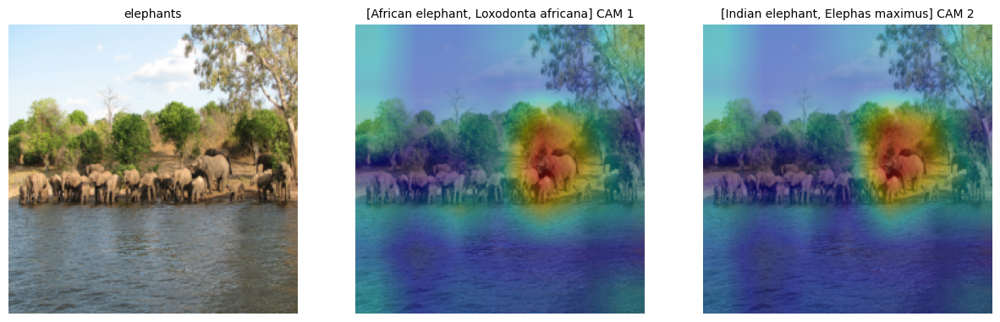

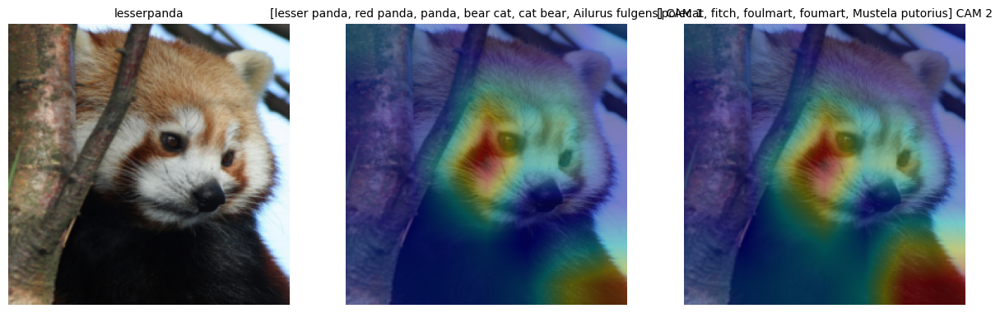

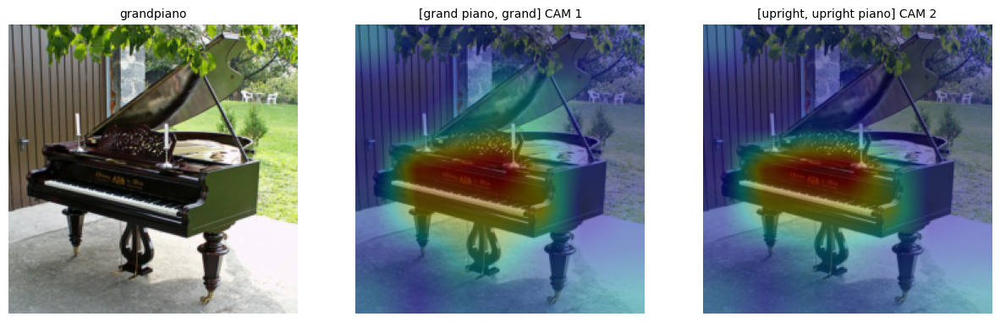

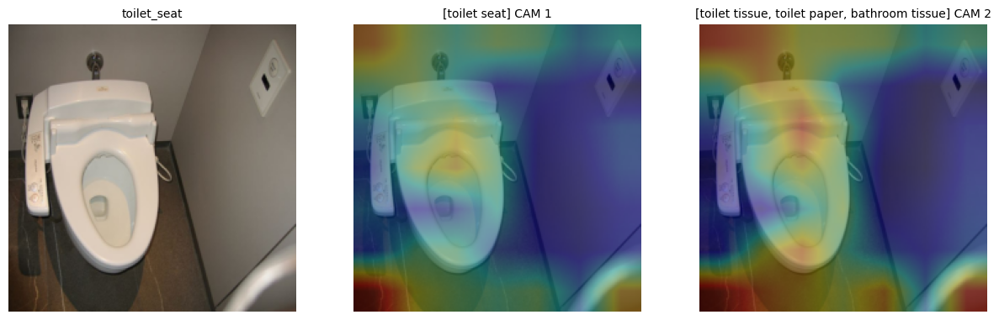

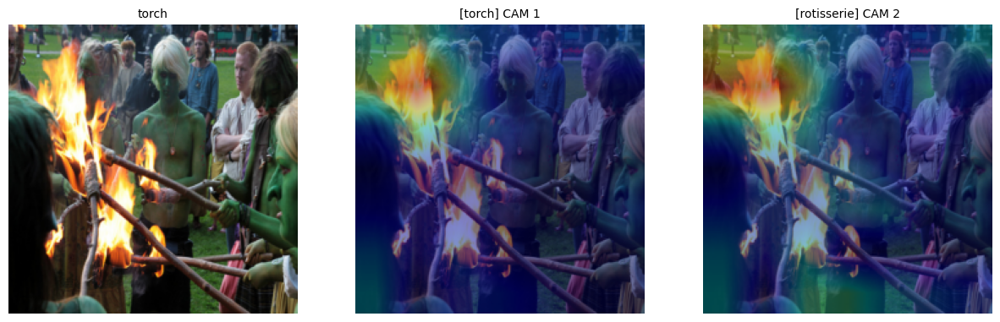

...

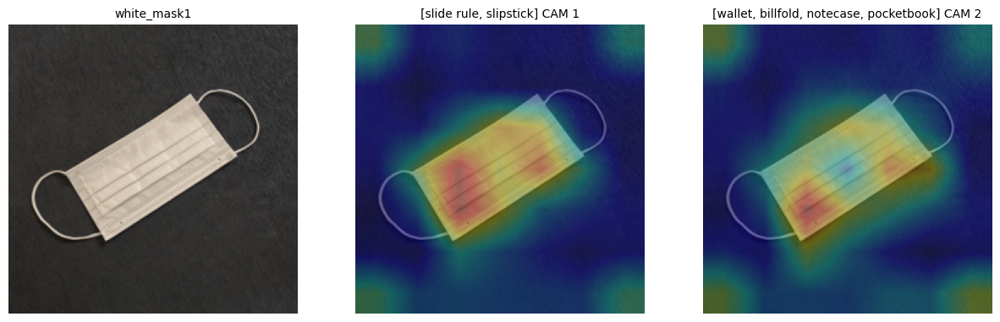

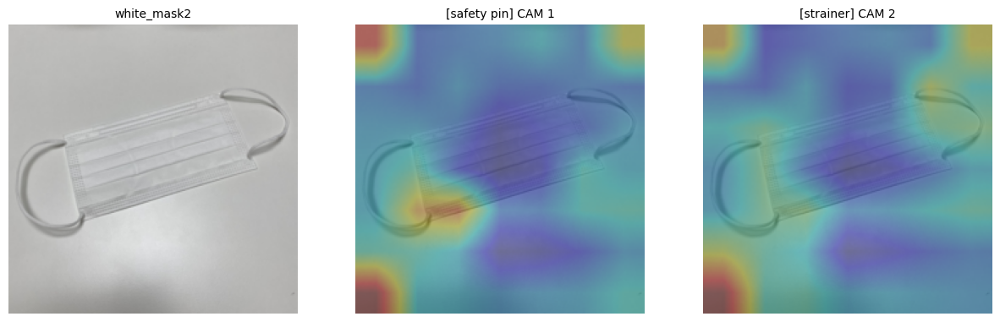

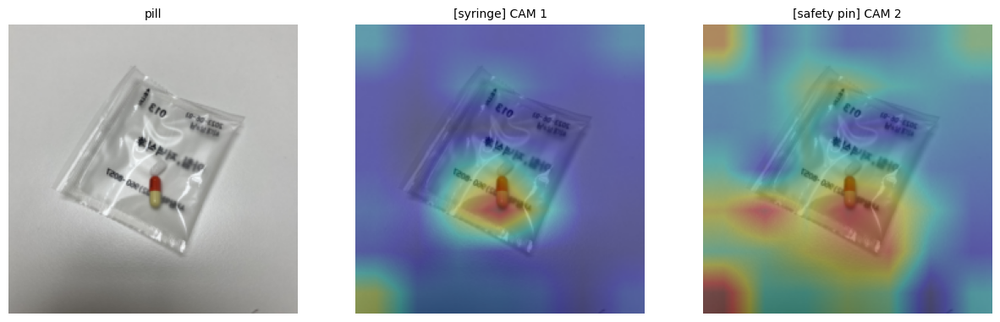

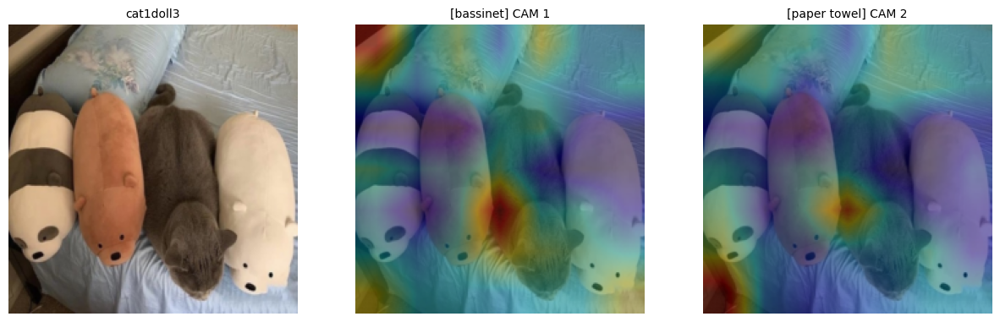

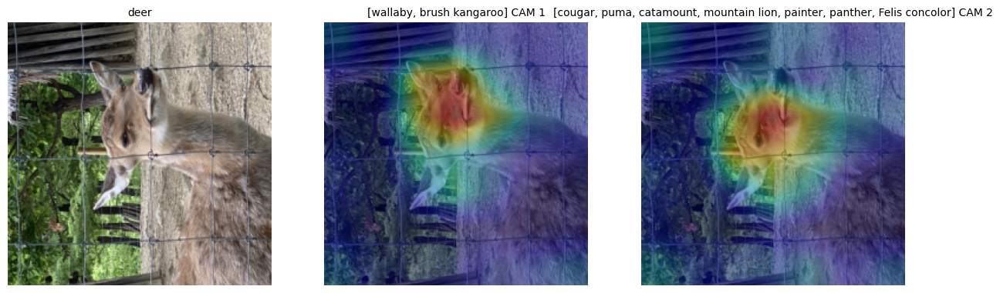

In [ ]:
for p in img_list:
    visualize_gradcam(*gradcam_exp(model_name='vgg19', img_path=p))

기존 Grad-CAM

In [ ]:
# 모델 이름과 이미지 경로 받아서 예측 후 coarse Grad-CAM과 예측 레이블 반환
def gradcam(model_name, img_path):
    raw_img = Image.open(img_path)
    img_input = preprocess1(raw_img).to(device).unsqueeze(dim=0)
    numpy_img = np.asarray(preprocess2(raw_img))

    model = GradCAM(model_name).to(device)
    model.eval()

    img_label = img_path[:-5]
    result = []
    cls_label = []

    # top-1,2
    for t in range(2):
        pred = model(img_input)
        cls_idx = torch.argsort(-pred, dim=1)[0][t]
        cls_label.append(classes[cls_idx.item()])

        pred[:, cls_idx].backward()
        gradients = model.gradients.detach() # gradients : (1, 512, feat_h, feat_w)
        attr = torch.mean(gradients, dim=[0,2,3]) # attr : (512,)
            # attribution of k-th channel of feature maps for each top-t class measured by average pooling
        feature_map = model.feature_extraction(img_input).detach() # feature_map : (1, 512, feat_h, feat_w)
        # coarse Grad-CAM
        for i in range(512):
            feature_map[:,i,:,:] *= attr[i]
        heatmap = F.relu(torch.sum(feature_map, dim=1).squeeze()) # heatmap : (feat_h, feat_w)
        # heatmap = torch.sum(feature_map, dim=1).squeeze() # relu 제외
        # heatmap 생성
        heatmap -= heatmap.min()
        heatmap /= heatmap.max()
        heatmap = np.uint8(255 * heatmap.cpu().numpy()) # 0~255 정수로 변환
        # colormap 변환 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
        heatmap = cv2.applyColorMap(cv2.resize(255-heatmap, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
        # heatmap 적용
        result.append(np.uint8(numpy_img*0.5 + heatmap*0.3))

    return numpy_img, result, img_label, cls_label # 원본 이미지 시각화 용도, grad-cam 시각화 용도 top-1,2, 예측 레이블 top-1,2

### base_resnet

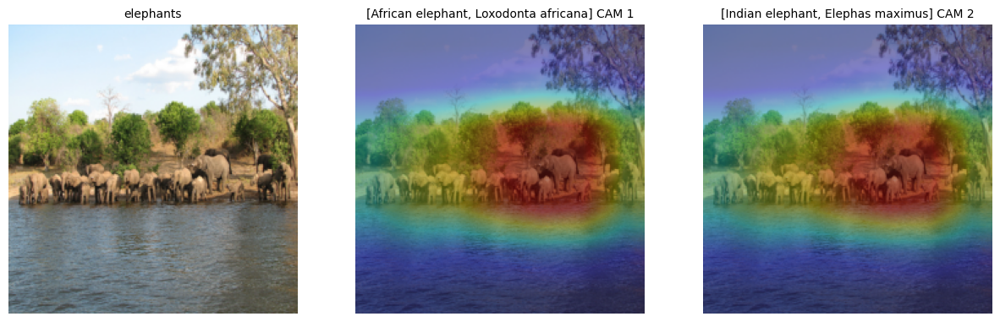

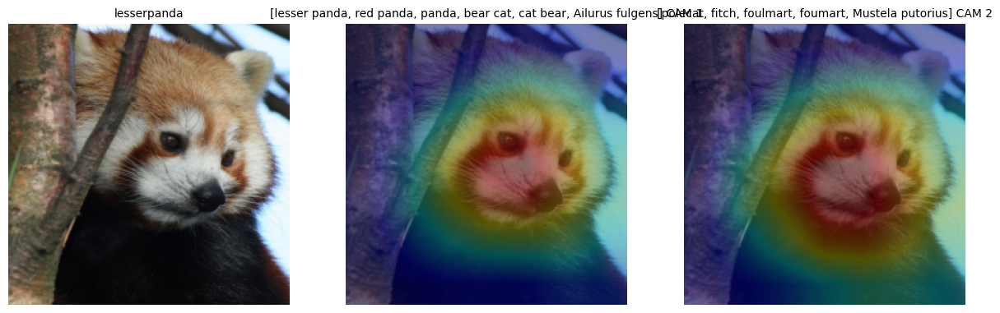

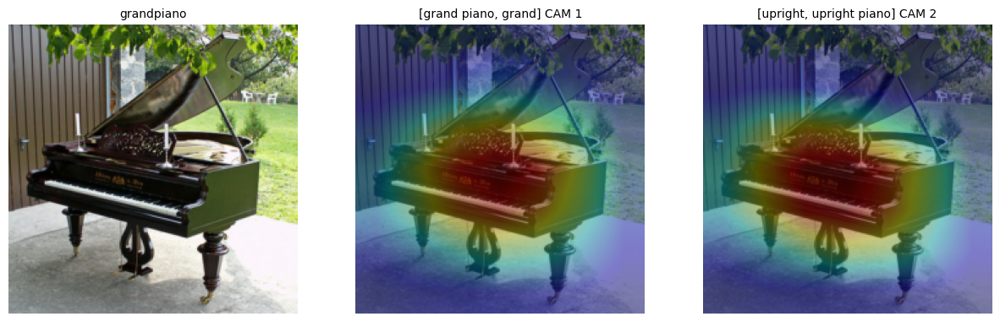

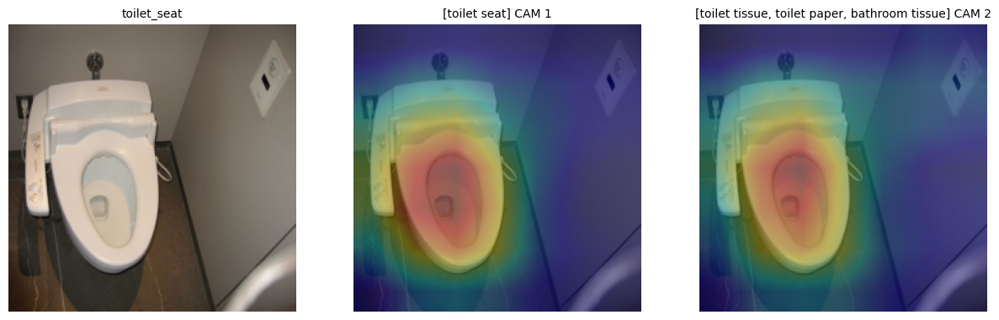

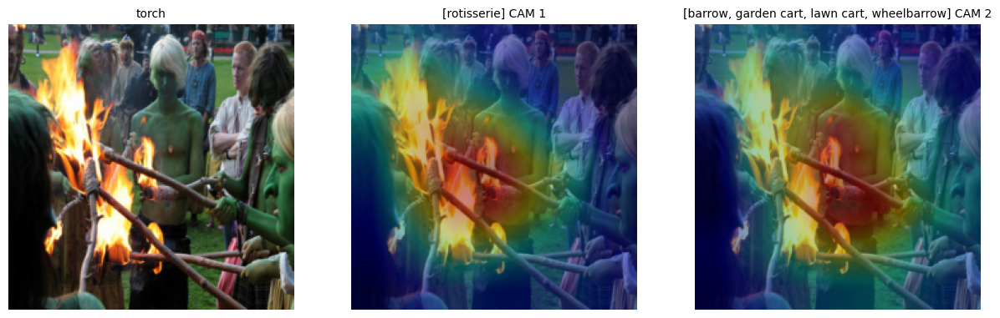

...

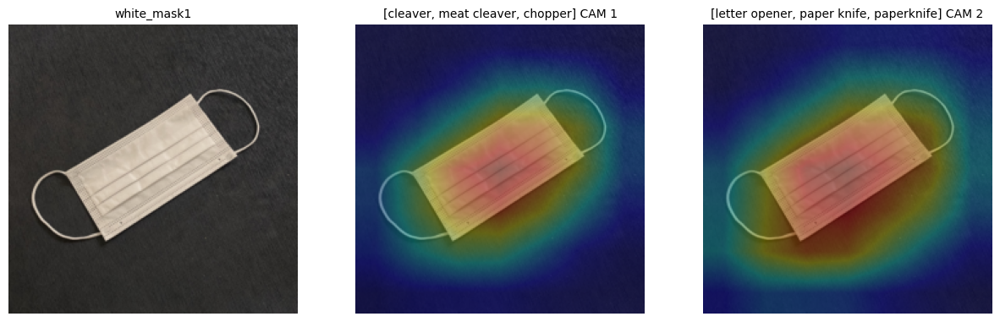

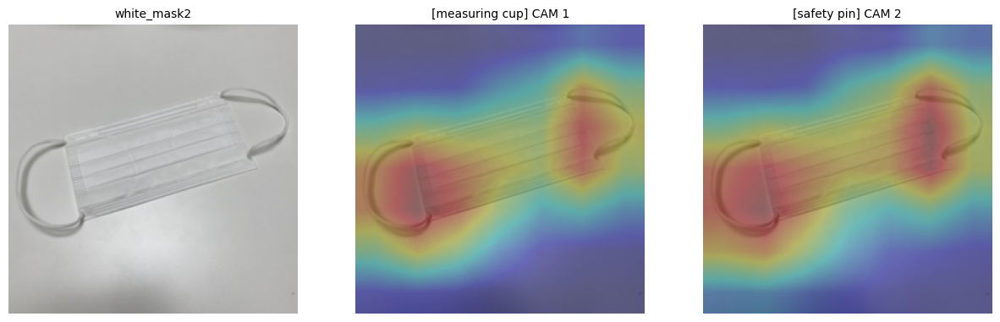

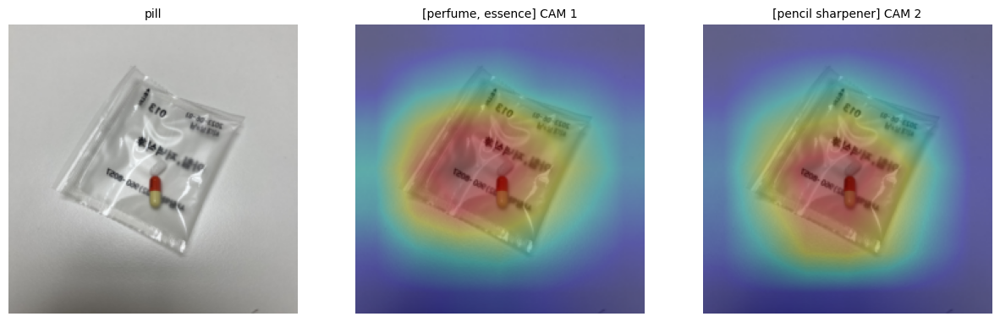

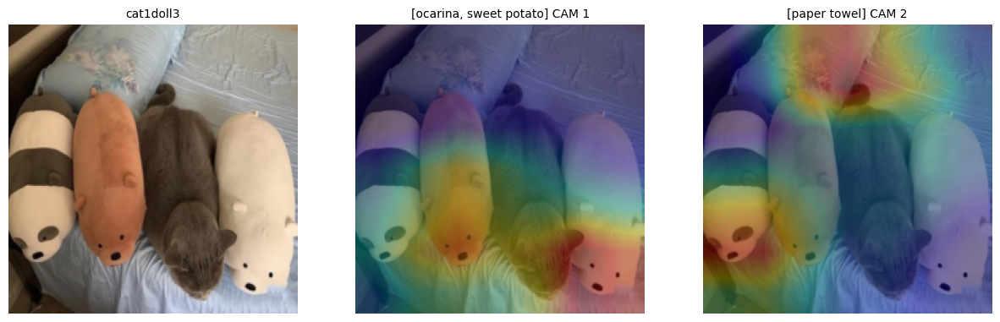

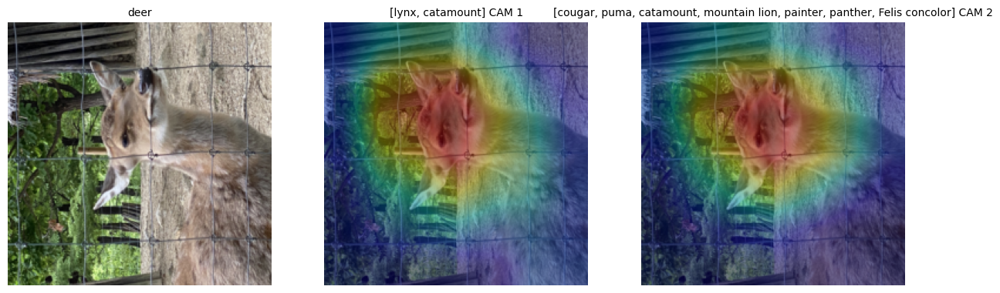

In [ ]:
for p in img_list:
    visualize_gradcam(*gradcam(model_name='resnet18', img_path=p))

### base_vgg

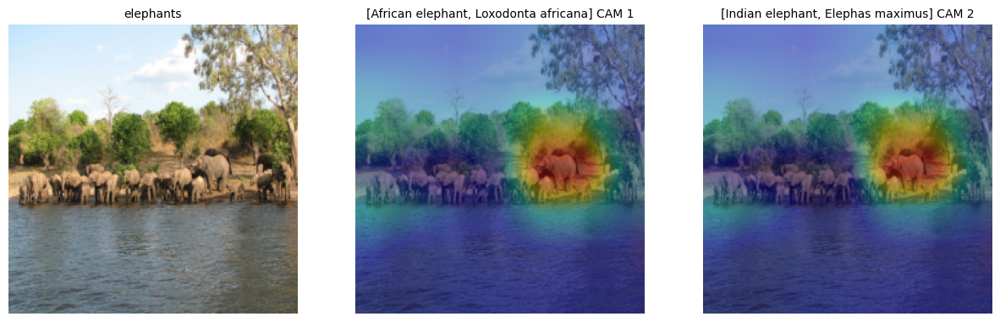

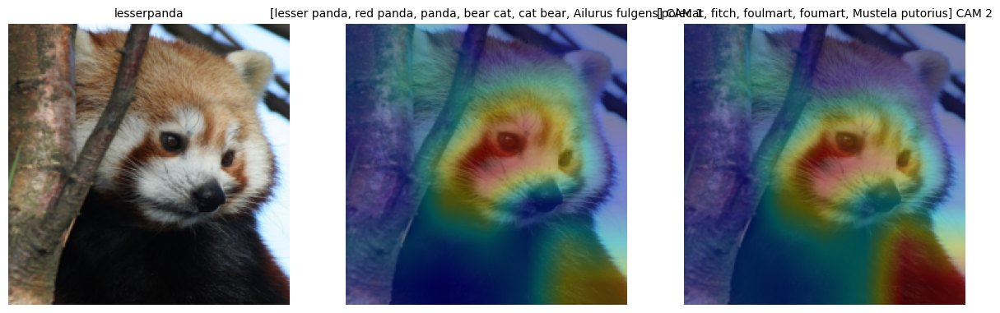

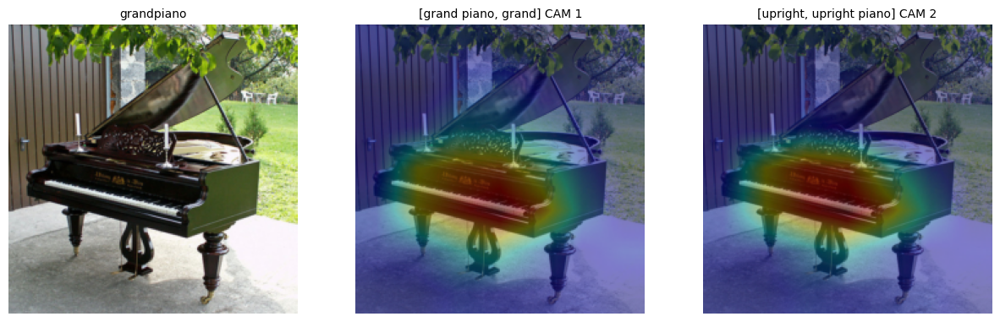

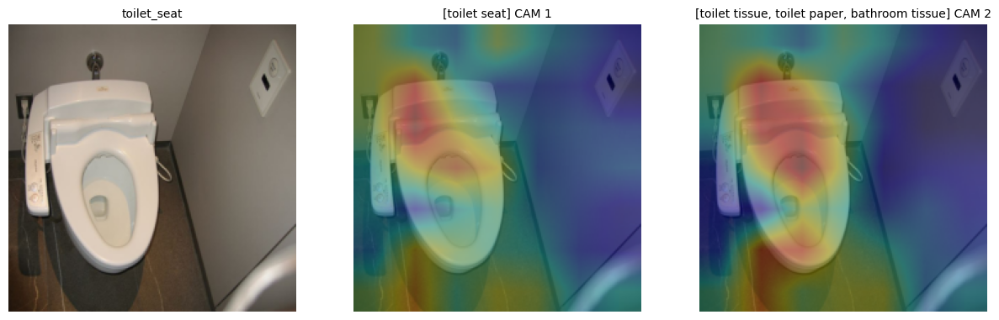

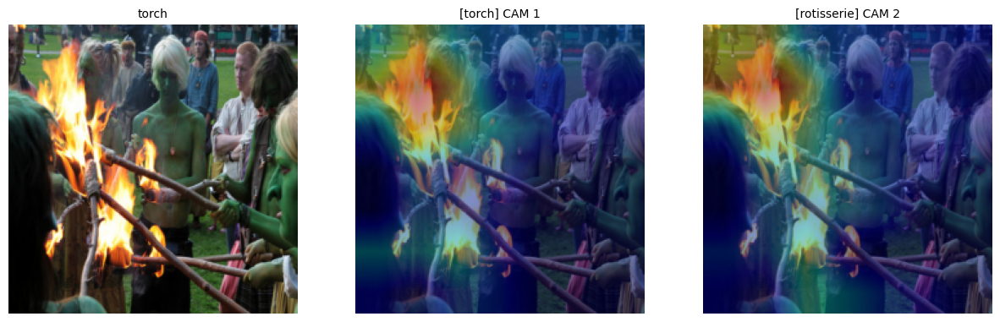

...

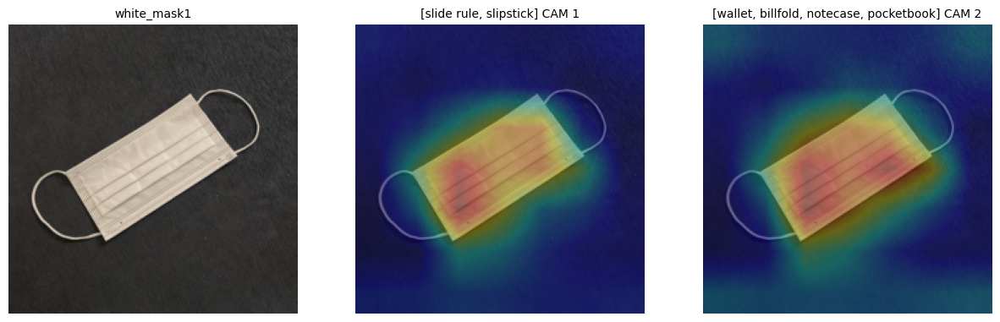

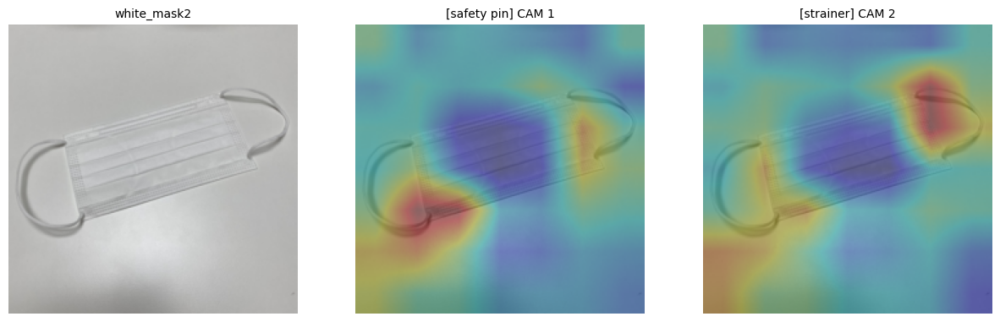

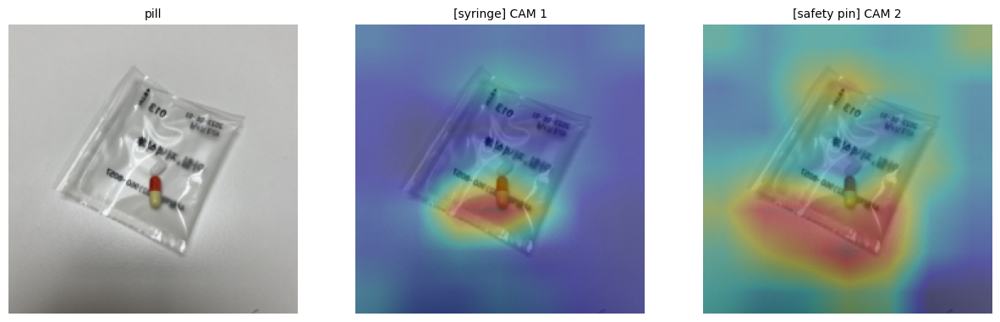

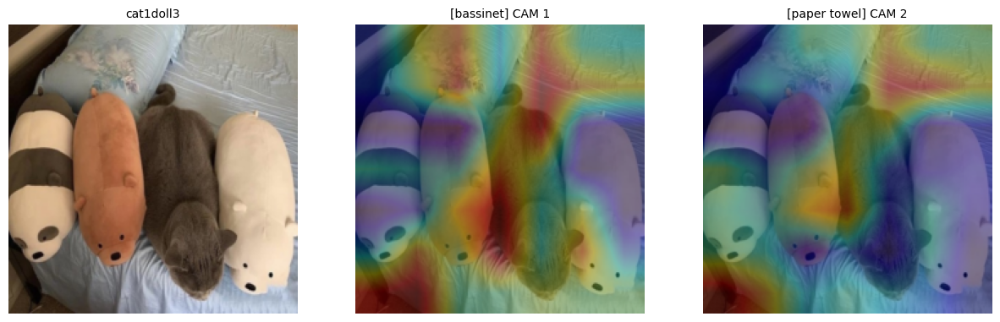

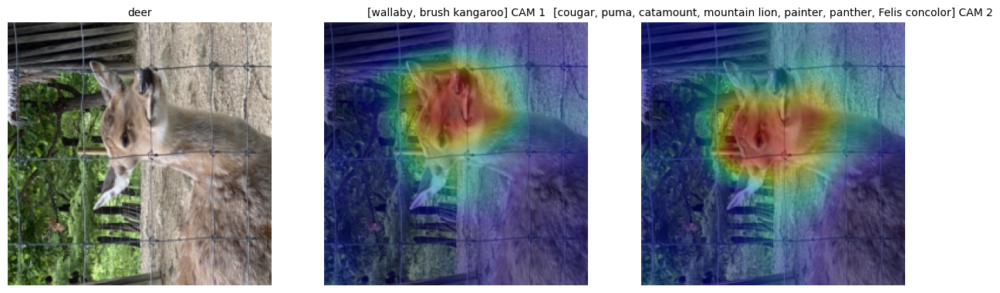

In [ ]:
for p in img_list:
    visualize_gradcam(*gradcam(model_name='vgg19', img_path=p))

### heatmap 비교

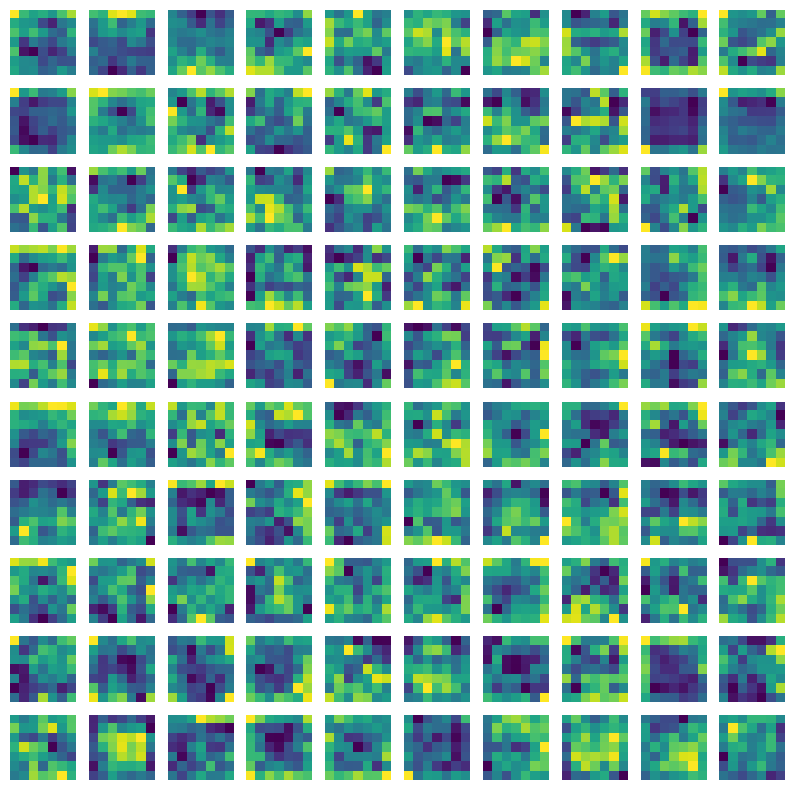

In [86]:
# 모델 이름과 이미지 경로 받아서 예측 후 coarse Grad-CAM과 예측 레이블 반환
(model_name, img_path)=('vgg19', 'ananas.jpg')
raw_img = Image.open(img_path)
img_input = preprocess1(raw_img).to(device).unsqueeze(dim=0)
numpy_img = np.asarray(preprocess2(raw_img))

model = GradCAM(model_name).to(device)
model.eval()

img_label = img_path[:-5]
result = []
cls_label = []

# top-1,2
for t in range(1):
    pred = model(img_input)
    cls_idx = torch.argsort(-pred, dim=1)[0][t]
    cls_label.append(classes[cls_idx.item()])

    pred[:, cls_idx].backward()
    gradients = model.gradients.detach() # gradients : (1, 512, feat_h, feat_w)

    '''기존의 gradcam과 다르게 구현'''
    attr = torch.mean(gradients, dim=[0,2,3]) # attr : (512,)
        # attribution of k-th channel of feature maps for each top-t class measured by average pooling
    feature_map = model.feature_extraction(img_input).detach() # feature_map : (1, 512, feat_h, feat_w)
    # coarse Grad-CAM
    # for i in range(512):
    #     feature_map[:,i,:,:] *= attr[i]
    feature_map = gradients
    n = 10
    f, a = plt.subplots(n,n, figsize=(10,10))
    for i in range(n**2):
        heatmap = feature_map[:,i,:,:].squeeze()

        #heatmap = F.relu(torch.sum(feature_map, dim=1).squeeze()) # heatmap : (feat_h, feat_w)
        #heatmap = torch.sum(feature_map, dim=1).squeeze() # relu 제외
        # heatmap 생성
        heatmap -= heatmap.min()
        heatmap /= heatmap.max()
        heatmap = np.uint8(255 * heatmap.cpu().numpy()) # 0~255 정수로 변환
        #print(heatmap)
        # colormap 변환 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
        # heatmap = cv2.applyColorMap(cv2.resize(255-heatmap, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
        # heatmap 적용
        # result.append(np.uint8(numpy_img*0.5 + heatmap*0.3))
        # plt.imshow(heatmap)
        # plt.show()
        a[i//n,i%n].imshow(heatmap)
        a[i//n,i%n].axis('off')

f.show()

In [80]:
# 모델 이름과 이미지 경로 받아서 예측 후 coarse Grad-CAM과 예측 레이블 반환
def gradcam_heatmap(model_name, img_path):
    raw_img = Image.open(img_path)
    img_input = preprocess1(raw_img).to(device).unsqueeze(dim=0)
    numpy_img = np.asarray(preprocess2(raw_img))

    model = GradCAM(model_name).to(device)
    model.eval()

    img_label = img_path[:-5]
    result = []
    cls_label = []

    # top-1,2
    for t in range(2):
        pred = model(img_input)
        cls_idx = torch.argsort(-pred, dim=1)[0][t]
        cls_label.append(classes[cls_idx.item()])

        pred[:, cls_idx].backward()
        gradients = model.gradients.detach() # gradients : (1, 512, feat_h, feat_w)
        attr = torch.mean(gradients, dim=[0,2,3]) # attr : (512,)
            # attribution of k-th channel of feature maps for each top-t class measured by average pooling
        feature_map = model.feature_extraction(img_input).detach() # feature_map : (1, 512, feat_h, feat_w)
        # coarse Grad-CAM
        for i in range(512):
            feature_map[:,i,:,:] *= attr[i]
        heatmap = F.relu(torch.sum(feature_map, dim=1).squeeze()) # heatmap : (feat_h, feat_w)
        # heatmap = torch.sum(feature_map, dim=1).squeeze() # relu 제외
        # heatmap 생성
        heatmap -= heatmap.min()
        heatmap /= heatmap.max()
        heatmap = np.uint8(255 * heatmap.cpu().numpy()) # 0~255 정수로 변환

        # colormap 변환 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
        # heatmap = cv2.applyColorMap(cv2.resize(255-heatmap, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
        # heatmap 적용
        # result.append(np.uint8(numpy_img*0.5 + heatmap*0.3))
        result.append(heatmap)

    return result

[[ 18   8   0   5   0   1   0]
 [ 22  10  22  77 138 154  78]
 [ 12  14  27 139 244 254  88]
 [  0   0   0  25 255 254   3]
 [  0   0   0   0 161 169  29]
 [ 18   0   0   0 108 162 143]
 [ 32  28  25  21  83  94  25]]


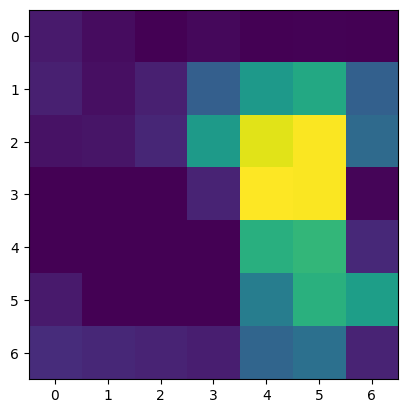

In [ ]:
# 기존 캠
heatmap_top_1 = gradcam_heatmap('vgg19', 'pineapple.JPEG')[0]
print(heatmap_top_1)
plt.imshow(heatmap_top_1);

In [ ]:
print(heatmap_top_1, exp_heatmap_top_1, sep='\n\n')

[[ 18   8   0   5   0   1   0]
 [ 22  10  22  77 138 154  78]
 [ 12  14  27 139 244 254  88]
 [  0   0   0  25 255 254   3]
 [  0   0   0   0 161 169  29]
 [ 18   0   0   0 108 162 143]
 [ 32  28  25  21  83  94  25]]

[[ 97  26  17  22  36  43 110]
 [ 26   3  15  57 123 125  71]
 [ 22   0  17 124 207 199  73]
 [ 10   0   0   0 219 242  23]
 [  0   0   0   0 225 255  13]
 [ 11   0   0   0 189 165 160]
 [ 71  32  30  42 126 153 157]]
